In [2]:
from icevision.all import *

In [3]:
checkpoint = torch.load('/home/kuntik/dev/epoch=99-step=32499.ckpt', map_location='cpu')

In [4]:
from src.modules.EfficientDetModule import EfficientDetModule
model_type = models.ross.efficientdet
backbone = model_type.backbones.tf_d4(pretrained=0)
det_model = model_type.model(backbone=backbone, num_classes = 2, img_size = 1024)
model = EfficientDetModule(det_model, 1e-4)

In [5]:
model.load_state_dict(checkpoint['state_dict'])

<All keys matched successfully>

In [6]:
from src.datamodules.DentalCaries import DentalCariesDataModule
model = model.model

In [7]:
dm = DentalCariesDataModule('/home/kuntik/carries_dataset', 1024, model_type)
dm.setup()
val = dm.val_dataloader()
# model.model

100%|██████████| 3079/3079 [00:00<00:00, 7907.76it/s]
INFO     - Autofixing records | icevision.parsers.parser:parse:122
100%|██████████| 1626/1626 [00:00<00:00, 23167.75it/s]


In [8]:
# inf_loader = model_type.infer_dl(dm.valid_ds, batch_size = 4, shuffle = False)
inf_loader_train = model_type.infer_dl(dm.valid_ds, batch_size = 4, shuffle = False)

In [9]:
# inference = model_type.infer_dl(v)
# preds = model_type.predict_from_dl(model, inf_loader, keep_images=True)
preds30 = model_type.predict_from_dl(model, inf_loader_train, keep_images=True, detection_threshold = 0.3)
# train_preds = model_type.predict_from_dl(model, inf_loader_train, keep_images=False, detection_threshold = 0.0)
# tds = dm.valid_ds

  0%|          | 0/82 [00:00<?, ?it/s]/home/kuntik/miniconda3/envs/ice/lib/python3.8/site-packages/effdet/bench.py:45: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  indices_all = cls_topk_indices_all // num_classes
100%|██████████| 82/82 [13:57<00:00, 10.22s/it]


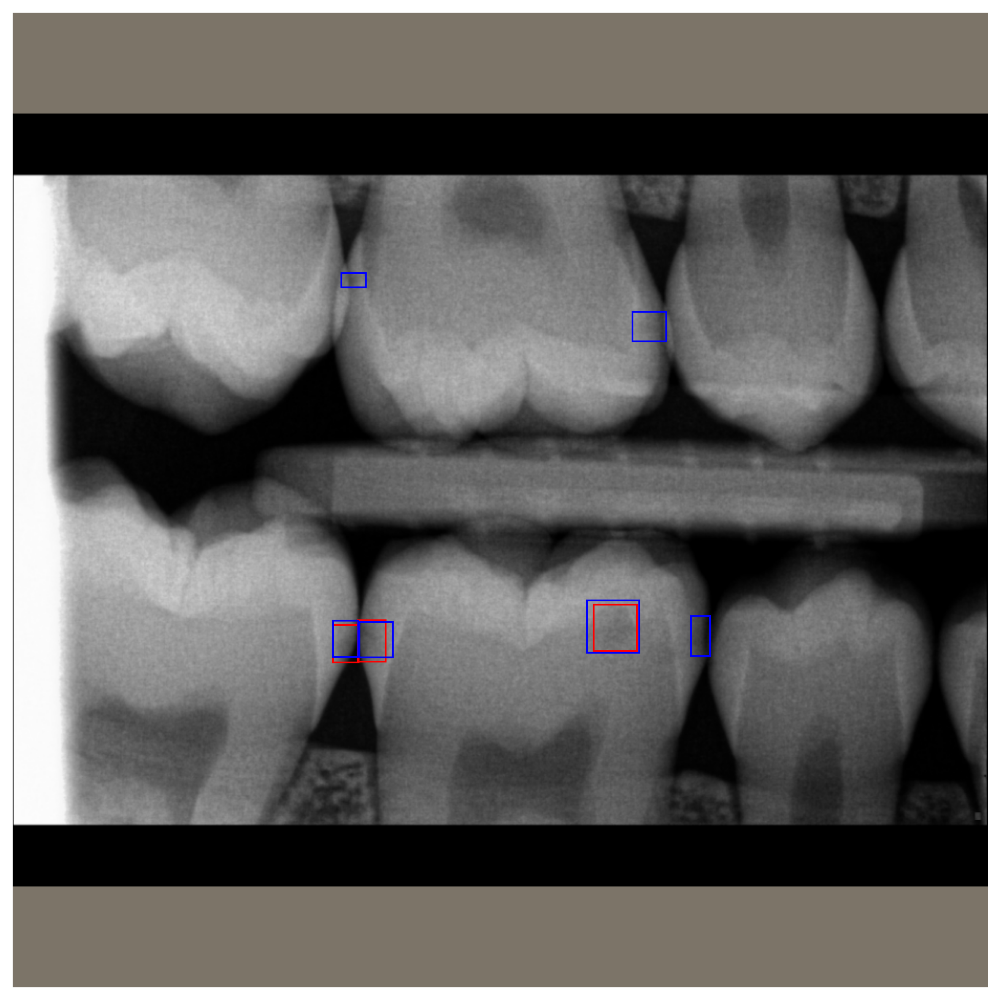

In [45]:
import matplotlib.patches as patches
def print_boxes(p, gt):
    fig, ax = plt.subplots(figsize=(14,10))
    im = p['common']['img']
    img = denormalize_imagenet(im)
    ax.imshow(img)
    fig.set_dpi(300)
    for box, score in zip(p['detection']['bboxes'], p['detection']['scores']):
        x,y,w,h = box.xywh
        rect= patches.Rectangle((x,y), w, h, linewidth=1, edgecolor='r', facecolor = 'none')
        ax.add_patch(rect)

    for box in gt['detection']['bboxes']:
        x,y,w,h = box.xywh
        rect= patches.Rectangle((x,y), w, h, linewidth=1, edgecolor='b', facecolor = 'none')
        ax.add_patch(rect)
    plt.axis('off')
    

        # rect = patchjs.Rec
i = 11
p = preds30[i].as_dict()        
g = preds30[i].ground_truth.as_dict()        

print_boxes(p, g)
plt.savefig('detection1.png', bbox_inches='tight')

{'common': {'filepath': Path('/home/kuntik/carries_dataset/images/1461.png'), 'img': array([[[  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        ...,
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917]],

       [[  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        ...,
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917]],

       [[  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        ...,
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.0081917],
        [  0.0055655,  -0.0049019,   0.

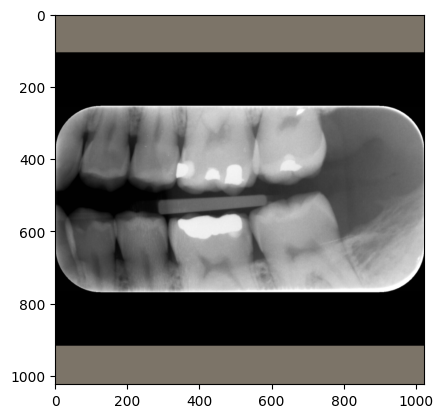

In [15]:
# print(preds30[0].common)
# foo = preds30[0].ground_truth.labels
d = preds30[5].as_dict()
g = preds30[0].ground_truth.as_dict()
# d['detection'].keys()
print(g)
g['detection']['bboxes'][0].xyxy
IMAGENET_STATS = ([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])

def denormalize_imagenet(img):
    mean, std = IMAGENET_STATS
    return denormalize(img=img, mean=mean, std=std)

im = d['common']['img']
im_den = denormalize_imagenet(im)
plt.imshow(im_den)



In [65]:
# preds30[0].ground_truth
metric = COCOMetric(metric_type=COCOMetricType.bbox)
metric.accumulate(train_preds)
metric_logs = metric.finalize()
metric_logs



{'AP (IoU=0.50:0.95) area=all': 0.2078667717327175,
 'AP (IoU=0.50) area=all': 0.5460127529905696,
 'AP (IoU=0.75) area=all': 0.09474865511964309,
 'AP (IoU=0.50:0.95) area=small': 0.16680644136766398,
 'AP (IoU=0.50:0.95) area=medium': 0.23975567102942047,
 'AP (IoU=0.50:0.95) area=large': 0.1538609475025098,
 'AR (IoU=0.50:0.95) area=all maxDets=1': 0.1311681508643269,
 'AR (IoU=0.50:0.95) area=all maxDets=10': 0.31917234154007335,
 'AR (IoU=0.50:0.95) area=all maxDets=100': 0.4003666841278156,
 'AR (IoU=0.50:0.95) area=small maxDets=100': 0.33977528089887643,
 'AR (IoU=0.50:0.95) area=medium maxDets=100': 0.4325833333333334,
 'AR (IoU=0.50:0.95) area=large maxDets=100': 0.3560606060606061}

In [113]:
show_preds(preds=preds30[0:8], figsize=(21,80))
import matplotlib.pyplot as plt
plt.gcf().set_dpi(300)
plt.savefig('foo.png')
# preds[3].detection.bboxes
# for i in range(50):
#     print(preds30[i].detection.scores)
# preds[0].detection.scores